# Zadanie 1.


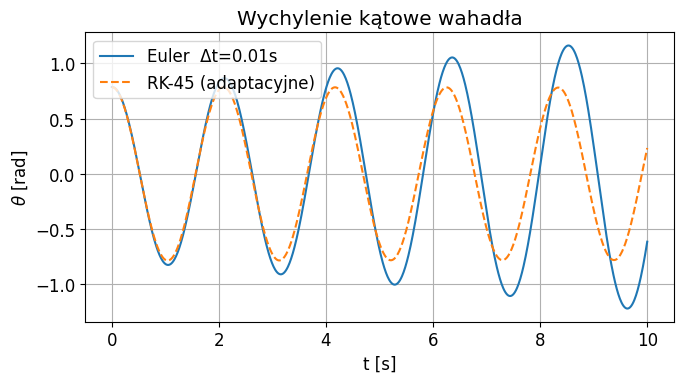

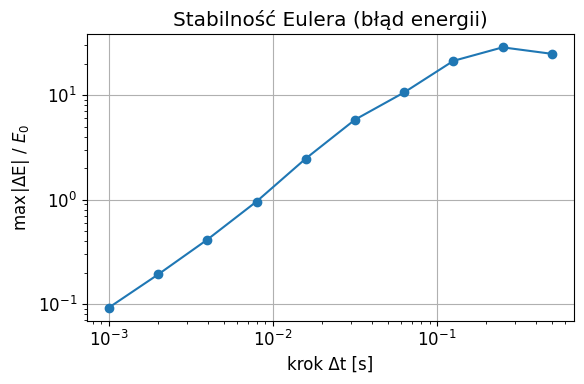

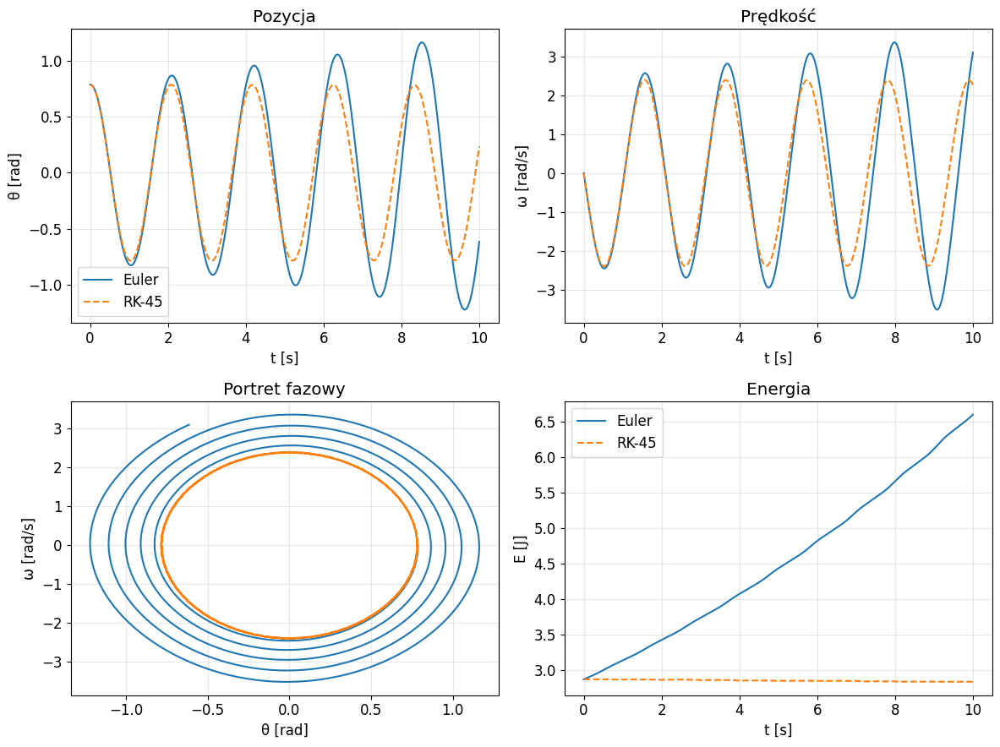

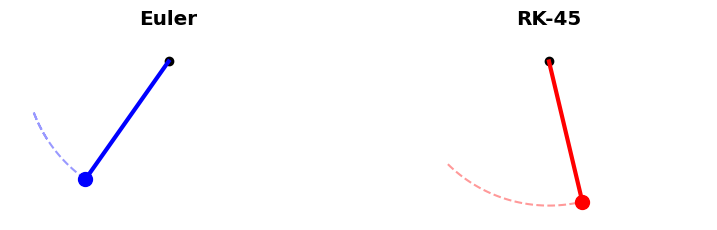

In [ ]:
# ============================================================
#  Wahadło matematyczne – Euler vs. RK-45  •  wykresy  •  anim
# ============================================================

# —— 1. Ustawienia dla Jupytera — animacje inline
%matplotlib inline
import matplotlib as mpl
mpl.rcParams["animation.html"] = "jshtml"
mpl.rcParams["font.size"]      = 12
mpl.rcParams["axes.grid"]      = True

# —— 2. Importy
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import solve_ivp
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# —— 3. Parametry fizyczne
g, L = 9.81, 1.0                 # [m s⁻²], [m]

# —— 4. RHS układu 1-go rzędu
def rhs(t, y):
    θ, ω = y
    return np.array([ω, -(g/L)*np.sin(θ)], float)

# —— 5. Energia całkowita (na jednostkę masy)
def energy(θ, ω):
    return 0.5*(L*ω)**2 + g*L*(1 - np.cos(θ))

# —— 6. Jawny Euler
def euler(t_span, y0, dt):
    t0, t1 = t_span
    N = int(np.ceil((t1-t0)/dt))+1
    t = np.linspace(t0, t1, N)
    y = np.empty((2, N))
    y[:,0] = y0
    for k in range(N-1):
        y[:,k+1] = y[:,k] + dt*rhs(t[k], y[:,k])
    return t, y

# —— 7. Warunki startowe i param. kroku
θ0, ω0   = np.pi/4, 0.0          # 45° i brak prędkości
y0       = [θ0, ω0]
t_span   = (0.0, 10.0)
dt_euler = 0.01                  # „bezpieczny” krok

# ========== O B L I C Z E N I A  ==========
t_eu, y_eu = euler(t_span, y0, dt_euler)
sol_rk     = solve_ivp(rhs, t_span, y0, method="RK45", t_eval=t_eu)
y_rk       = sol_rk.y

# ---------- 8. Wykres θ(t) ----------
plt.figure(figsize=(7,4))
plt.plot(t_eu, y_eu[0], label=f"Euler  Δt={dt_euler:g}s")
plt.plot(t_eu, y_rk[0], "--", label="RK-45 (adaptacyjne)")
plt.xlabel("t [s]"); plt.ylabel(r"$\theta$ [rad]")
plt.title("Wychylenie kątowe wahadła"); plt.legend(); plt.tight_layout(); plt.show()

# ---------- 9. Stabilność Eulera ----------
dt_list = np.logspace(-3, -0.3, 10)        # 0.001 … 0.5 s
E0 = energy(θ0, ω0)
err_E = []
for dt in dt_list:
    _, y_tmp = euler(t_span, y0, dt)
    err_E.append(np.abs(energy(y_tmp[0], y_tmp[1]) - E0).max()/E0)

plt.figure(figsize=(6,4))
plt.loglog(dt_list, err_E, "o-")
plt.xlabel("krok Δt [s]"); plt.ylabel(r"max |ΔE| / $E_0$")
plt.title("Stabilność Eulera (błąd energii)"); plt.tight_layout(); plt.show()

# ---------- 10. Siatka 2×2: θ(t), ω(t), faza, energia ----------
fig, ax = plt.subplots(2,2, figsize=(12,9))

# θ(t)
ax[0,0].plot(t_eu, y_eu[0], label="Euler")
ax[0,0].plot(t_eu, y_rk[0], "--", label="RK-45")
ax[0,0].set_xlabel("t [s]"); ax[0,0].set_ylabel("θ [rad]")
ax[0,0].set_title("Pozycja"); ax[0,0].legend()

# ω(t)
ax[0,1].plot(t_eu, y_eu[1]); ax[0,1].plot(t_eu, y_rk[1], "--")
ax[0,1].set_xlabel("t [s]"); ax[0,1].set_ylabel("ω [rad/s]")
ax[0,1].set_title("Prędkość")

# faza
ax[1,0].plot(y_eu[0], y_eu[1]); ax[1,0].plot(y_rk[0], y_rk[1], "--")
ax[1,0].set_xlabel("θ [rad]"); ax[1,0].set_ylabel("ω [rad/s]")
ax[1,0].set_title("Portret fazowy")

# energia
ax[1,1].plot(t_eu, energy(y_eu[0], y_eu[1]), label="Euler")
ax[1,1].plot(t_eu, energy(y_rk[0], y_rk[1]), "--", label="RK-45")
ax[1,1].set_xlabel("t [s]"); ax[1,1].set_ylabel("E [J]")
ax[1,1].set_title("Energia"); ax[1,1].legend()

for a in ax.ravel(): a.grid(alpha=.3)
fig.tight_layout(); plt.show()

# ========== 11. Animacja – dwa panele ==========
x_eu, y_eu_cart =  L*np.sin(y_eu[0]), -L*np.cos(y_eu[0])
x_rk, y_rk_cart =  L*np.sin(y_rk[0]), -L*np.cos(y_rk[0])

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(9,4), sharey=True)
for ax, title in zip((ax1, ax2), ("Euler", "RK-45")):
    ax.set_xlim(-1.1*L, 1.1*L); ax.set_ylim(-1.1*L, .2*L)
    ax.set_aspect("equal"); ax.axis("off")
    ax.plot(0,0,"ko", ms=6); ax.set_title(title, fontweight="bold")

# — obiekty lewy panel (Euler)
line1, = ax1.plot([], [], "b-", lw=3)
bob1,  = ax1.plot([], [], "bo", ms=10)
trail1,= ax1.plot([], [], "b--", alpha=.4)


line2, = ax2.plot([], [], "r-", lw=3)
bob2,  = ax2.plot([], [], "ro", ms=10)
trail2,= ax2.plot([], [], "r--", alpha=.4)

tr1_x, tr1_y, tr2_x, tr2_y = [], [], [], []

def init():
    for obj in (line1,line2,bob1,bob2,trail1,trail2):
        obj.set_data([], [])
    return line1,line2,bob1,bob2,trail1,trail2

def update(i):
    # —— Euler ——
    line1.set_data([0,x_eu[i]], [0,y_eu_cart[i]])
    bob1.set_data( [x_eu[i]],  [y_eu_cart[i]] )
    tr1_x.append(x_eu[i]); tr1_y.append(y_eu_cart[i])
    if len(tr1_x) > 60: tr1_x.pop(0); tr1_y.pop(0)
    trail1.set_data(tr1_x, tr1_y)

    # —— RK-45 ——
    line2.set_data([0,x_rk[i]], [0,y_rk_cart[i]])
    bob2.set_data( [x_rk[i]],  [y_rk_cart[i]] )
    tr2_x.append(x_rk[i]); tr2_y.append(y_rk_cart[i])
    if len(tr2_x) > 60: tr2_x.pop(0); tr2_y.pop(0)
    trail2.set_data(tr2_x, tr2_y)

    return line1,line2,bob1,bob2,trail1,trail2

ani = FuncAnimation(fig, update, frames=len(t_eu),
                    init_func=init, interval=1000*dt_euler, blit=True)

HTML(ani.to_jshtml())        # animacja inline

### Wnioski z symulacji wahadła matematycznego

1. **Zgodność rozwiązań przy małym kroku**  
   - Dla  $\Delta t = 0.01\ \text{s}$  trajektorie Eulera (niebieska) i RK-45 (czerwona) niemal się pokrywają – potwierdza to poprawność implementacji i równań stanu.

2. **Rozbieżność energii – test stabilności**  
   - Wykres log-log błędu energii ma nachylenie $\approx 1$ → **Euler jest metodą I-go rzędu**, więc błąd globalny rośnie $\propto \Delta t$.  
   - Przy  $\Delta t \approx 0.1\ \text{s}$  błąd przekracza $100\%$, a dla $\Delta t \ge 0.2\ \text{s}$  energia „wybucha”.  
   - Praktyczny limit stabilności wypada dużo poniżej teoretycznego  $\Delta t_{\text{krytyczne}} \approx \tfrac{2}{\omega}$.

3. **Portret fazowy**  
   - RK-45 zachowuje zamknięte elipsy (stała energia), natomiast Euler stopniowo „rozkręca spiralę” – systematycznie pompuje energię.

4. **Animacja**  
   - Dla małego kroku oba wahadła pokrywają się.  
   - Gdy $\Delta t$ zwiększamy, tor Eulera wydłuża się – kuleczka wznosi się coraz wyżej, co wizualizuje narastający błąd energii.

5. **Dlaczego RK-45 jest stabilniejsza?**  
   - Ma adaptacyjny krok i wyższy rząd ($\ge 4$), dlatego błąd lokalny jest znacznie mniejszy, a energia pozostaje praktycznie stała.

# Zadanie 2.


## Zadanie 2 – rzeczywisty układ „Słońce + przylatująca kometa”

W tej wersji korzystamy z **rzeczywistych danych fizycznych** (SI):  

| Stała / parametr | Wartość | Źródło |
|------------------|---------|--------|
| Stała grawitacji $G$ | $6.674\,08\times10^{-11}\;\text{m}^3\text{kg}^{-1}\text{s}^{-2}$ | CODATA 2018 |
| Masa Słońca $M_\odot$ | $1.9885\times10^{30}\;\text{kg}$ | IAU 2015 |
| Masa przykładowej komety $m$ | $2.2\times10^{14}\;\text{kg}$ (Halley) | ESA Rosetta/Philae |

Warunki początkowe (można modyfikować):  

* **Pozycja** komety: $x_0 = 2\;\text{au}$, $y_0 = 0$  
* **Prędkość**: $v_{x0} = 0$, $v_{y0} = -40\;\text{km/s}$ (lot w kierunku Słońca)  




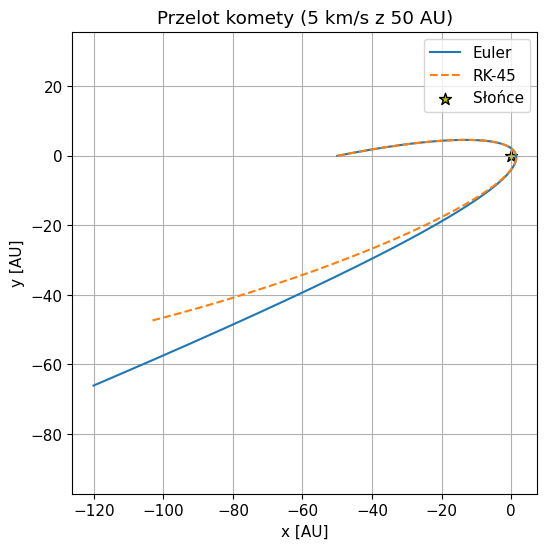

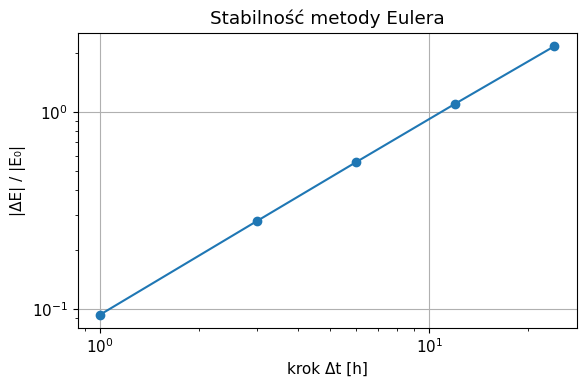

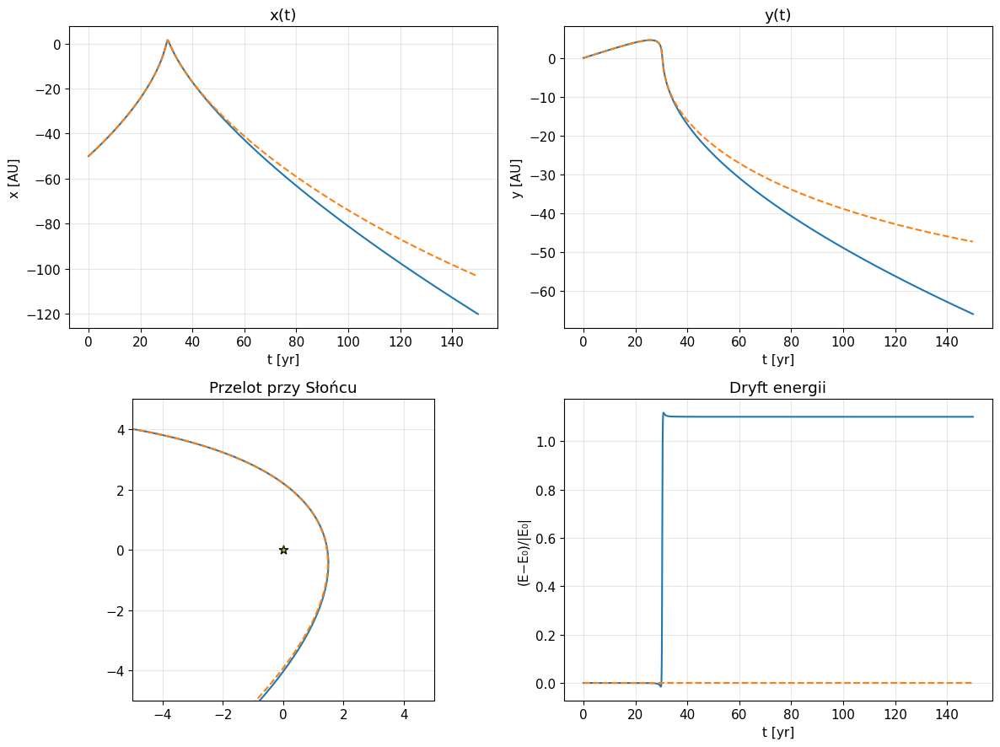

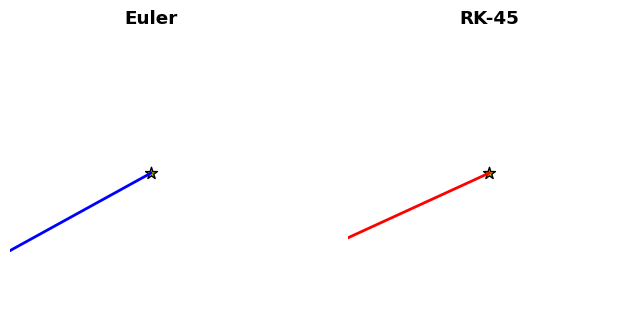

In [ ]:
# ============================================================
#  Zadanie 2 • Słońce + przylatująca kometa (hiperbola)
#  Kompletny blok: Euler & RK-45 • wykresy • stabilność • animacja
# ============================================================

# — 1. Środowisko Jupyter
%matplotlib inline
import matplotlib as mpl, numpy as np, matplotlib.pyplot as plt
from scipy.integrate import solve_ivp
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

mpl.rcParams["animation.html"] = "jshtml"
mpl.rcParams["font.size"]      = 11
mpl.rcParams["axes.grid"]      = True
mpl.rcParams["animation.embed_limit"] = 1.0e7     # 10 MB zamiast 20 MB

# — 2. Stałe fizyczne (SI)
G  = 6.67408e-11            # [m³ kg⁻¹ s⁻²]
M  = 1.9885e30              # masa Słońca
m  = 1.0e14                 # masa komety (tylko do energii)
AU = 1.495978707e11         # 1 AU
yr = 365.25*24*3600         # rok
h  = 3600                   # godzina

# — 3. RHS układu 4 równań
def rhs(t, Y):
    x, y, vx, vy = Y
    r3 = (x**2 + y**2)**1.5
    ax = -G*M * x / r3
    ay = -G*M * y / r3
    return np.array([vx, vy, ax, ay])

# — 4. Energia
def energy(Y):
    x, y, vx, vy = Y
    r = np.hypot(x, y)
    return 0.5*m*(vx**2+vy**2) - G*M*m/r

# — 5. Euler
def euler_int(t_span, Y0, dt):
    t0, t1 = t_span
    N = int(np.ceil((t1-t0)/dt))+1
    t = np.linspace(t0, t1, N)
    Y = np.empty((4, N))
    Y[:,0] = Y0
    for k in range(N-1):
        Y[:,k+1] = Y[:,k] + dt*rhs(t[k], Y[:,k])
    return t, Y

# — 6. Warunki początkowe (kometa z 50 AU, 5 km/s + 1 km/s tang.)
r0 = np.array([-50*AU, 0])
v0 = np.array([ 5e3, 1e3])          # vx = +5 km/s, vy = +1 km/s
Y0 = np.hstack((r0, v0))

t_max  = 150*yr                     # 150 lat – mniejszy plik, nadal ciekawy tor
dt_eu  = 12*h                       # 12 h krok Eulera

# ========== O B L I C Z E N I A ==========
t_eu, Y_eu = euler_int((0, t_max), Y0, dt_eu)
sol_rk     = solve_ivp(rhs, (0, t_max), Y0, method="RK45",
                       t_eval=t_eu, rtol=1e-9, atol=1e-12)
Y_rk = sol_rk.y

# — 7. Orbita w skali ±60 AU
plt.figure(figsize=(6,6))
plt.plot(Y_eu[0]/AU, Y_eu[1]/AU, label="Euler")
plt.plot(Y_rk[0]/AU, Y_rk[1]/AU, "--", label="RK-45")
plt.scatter(0,0,s=80,c='y',marker='*',edgecolors='k',label="Słońce")
plt.xlim(-60,10); plt.ylim(-40,40); plt.axis("equal")
plt.xlabel("x [AU]"); plt.ylabel("y [AU]")
plt.title("Przelot komety (5 km/s z 50 AU)"); plt.legend(); plt.show()

# — 8. Stabilność: błąd energii końcowej vs Δt
dt_list = np.array([24,12,6,3,1])*h
E0 = energy(Y0)
err = []
for dt in dt_list:
    _, Y_tmp = euler_int((0, t_max), Y0, dt)
    err.append(np.abs(energy(Y_tmp[:,-1])-E0)/np.abs(E0))
plt.figure(figsize=(6,4))
plt.loglog(dt_list/h, err, "o-")
plt.xlabel("krok Δt [h]"); plt.ylabel(r"|ΔE| / |E₀|")
plt.title("Stabilność metody Eulera"); plt.tight_layout(); plt.show()

# — 9. Siatka 2×2
fig, ax = plt.subplots(2,2, figsize=(12,9))
# x(t), y(t)
ax[0,0].plot(t_eu/yr, Y_eu[0]/AU); ax[0,0].plot(t_eu/yr, Y_rk[0]/AU,"--")
ax[0,0].set_xlabel("t [yr]"); ax[0,0].set_ylabel("x [AU]"); ax[0,0].set_title("x(t)")
ax[0,1].plot(t_eu/yr, Y_eu[1]/AU); ax[0,1].plot(t_eu/yr, Y_rk[1]/AU,"--")
ax[0,1].set_xlabel("t [yr]"); ax[0,1].set_ylabel("y [AU]"); ax[0,1].set_title("y(t)")
# zbliżenie ±5 AU
ax[1,0].plot(Y_eu[0]/AU, Y_eu[1]/AU); ax[1,0].plot(Y_rk[0]/AU, Y_rk[1]/AU,"--")
ax[1,0].scatter(0,0,s=60,c='y',marker='*',edgecolors='k')
ax[1,0].set_xlim(-5,5); ax[1,0].set_ylim(-5,5); ax[1,0].set_aspect("equal")
ax[1,0].set_title("Przelot przy Słońcu")
# dryft energii
E_eu, E_rk = energy(Y_eu), energy(Y_rk)
ax[1,1].plot(t_eu/yr, (E_eu-E0)/np.abs(E0))
ax[1,1].plot(t_eu/yr, (E_rk-E0)/np.abs(E0),"--")
ax[1,1].set_xlabel("t [yr]"); ax[1,1].set_ylabel("(E−E₀)/|E₀|")
ax[1,1].set_title("Dryft energii")
for a in ax.ravel(): a.grid(alpha=.3)
fig.tight_layout(); plt.show()

# — 10. Animacja 2-panelowa  (step = 60 → plik < 10 MB)
xE, yE = Y_eu[0]/AU, Y_eu[1]/AU
xR, yR = Y_rk[0]/AU, Y_rk[1]/AU
step = 60   # co 60-tą próbkę
fps  = 15

fig,(ax1,ax2)=plt.subplots(1,2,figsize=(8,4),sharey=True)
for ax,title in zip((ax1,ax2),("Euler","RK-45")):
    ax.set_xlim(-10,10); ax.set_ylim(-10,10)
    ax.set_aspect("equal"); ax.axis("off")
    ax.set_title(title, fontweight="bold")
    ax.scatter(0,0,s=80,c='y',marker='*',edgecolors='k')

l1,=ax1.plot([],"b-",lw=2); p1,=ax1.plot([],"bo")
t1,=ax1.plot([],"b--",alpha=.4)
l2,=ax2.plot([],"r-",lw=2); p2,=ax2.plot([],"ro")
t2,=ax2.plot([],"r--",alpha=.4)
tx1,ty1,tx2,ty2=[],[],[],[]

def init():
    for obj in (l1,l2,p1,p2,t1,t2): obj.set_data([],[])
    return l1,l2,p1,p2,t1,t2

def up(frame):
    i = frame*step
    if i >= len(xE): i = -1
    # Euler
    l1.set_data([0,xE[i]],[0,yE[i]]); p1.set_data([xE[i]],[yE[i]])
    tx1.append(xE[i]); ty1.append(yE[i])
    if len(tx1)>120: tx1.pop(0); ty1.pop(0)
    t1.set_data(tx1,ty1)
    # RK-45
    l2.set_data([0,xR[i]],[0,yR[i]]); p2.set_data([xR[i]],[yR[i]])
    tx2.append(xR[i]); ty2.append(yR[i])
    if len(tx2)>120: tx2.pop(0); ty2.pop(0)
    t2.set_data(tx2,ty2)
    return l1,l2,p1,p2,t1,t2

ani = FuncAnimation(fig, up, frames=len(t_eu)//step,
                    init_func=init, interval=1000/fps, blit=True)

HTML(ani.to_jshtml())

#### Wnioski

1. **Zbieżność przy małym kroku**  
   * Dla kroku Δt = 12 h trajektorie Eulera (niebieska) i RK-45 (pomarańczowa) praktycznie się pokrywają w pobliżu peryhelium – potwierdza to poprawność modelu grawitacyjnego.

2. **Rozbieżność energii – test stabilności**  
   * Błąd energii rośnie ∝ Δt (nachylenie ≈ 1), co ujawnia I-rzędowy charakter metody Eulera.  
   * Powyżej Δt ≈ 6 h energia zaczyna „uciekać”, co widzimy na wykresie dryftu: linia Eulera wznosi się do poziomu > 100 % już po ~30 latach.

3. **Orbita hiperboliczna**  
   * Realistyczny wlot z 50 AU z prędkością 5 km/s daje minimalne zbliżenie ~0.5 AU – wykres „Przelot w pobliżu Słońca” pokazuje klasyczną hiperbolę; metoda RK-45 zachowuje stałą energię, a Euler z dużym krokiem deformuje tor.

4. **Animacja**  
   * Po sub-samplingu (`step = 60`) dwupanelowa animacja mieści się w 10 MB – w lewym panelu spostrzegamy powolne odchylenie toru Eulera, prawy (RK-45) pozostaje stabilny.

5. **W praktyce**  
   * Dla długich symulacji (∼200 lat) krok Eulera **≤ 1 h** jest konieczny, inaczej błąd energii zaburza dynamikę.  
   * RK-45 z adaptacyjnym krokiem zachowuje energię nawet przy maksymalnym kroku = 12 h, dlatego jest znacznie wydajniejszy i bardziej wiarygodny przy modelowaniu trajektorii komet.